# Setup

In [1]:
from google.colab import drive
drive.mount('/content/drive', force_remount=True)

Mounted at /content/drive


In [2]:
import os
import torch
import tqdm
import matplotlib.pyplot as plt
os.chdir("drive/MyDrive/")
os.listdir()

['Recommendations.gdoc',
 'Colab Notebooks',
 'Summary_v0.gdoc',
 'Untitled document (1).gdoc',
 'References.gdoc',
 'Reinforcement learning for process synthesis.gdoc',
 'Optimisation_Coursework_2_FIRST_DRAFT.pdf',
 'Second_Draft Optimisation.pdf',
 'Thrid_Draft optimisation.pdf',
 'H801P-assignment2.pdf',
 'Speech1.pdf',
 'Advanced Machine learning paper summaries.gdoc',
 'Speech_Generation_KWS_coursework-final (2).pdf',
 '1542457.pdf',
 'Case2.pdf',
 '.ipynb_checkpoints',
 'test.txt',
 'Untitled document.gdoc',
 'TODO.gdoc',
 'Untitled spreadsheet.gsheet',
 'Schedule.gsheet',
 'Final year',
 'Boltzmann_1',
 'Learn_JAX',
 'PytorchThesis']

In [3]:
!nvidia-smi

Sun Jul 11 22:18:59 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 470.42.01    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   38C    P0    27W / 250W |      0MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

# Git Clone if need be

## If we want to remove exisiting code

In [4]:
!rm -r PytorchThesis/

In [5]:
os.listdir()

['Recommendations.gdoc',
 'Colab Notebooks',
 'Summary_v0.gdoc',
 'Untitled document (1).gdoc',
 'References.gdoc',
 'Reinforcement learning for process synthesis.gdoc',
 'Optimisation_Coursework_2_FIRST_DRAFT.pdf',
 'Second_Draft Optimisation.pdf',
 'Thrid_Draft optimisation.pdf',
 'H801P-assignment2.pdf',
 'Speech1.pdf',
 'Advanced Machine learning paper summaries.gdoc',
 'Speech_Generation_KWS_coursework-final (2).pdf',
 '1542457.pdf',
 'Case2.pdf',
 '.ipynb_checkpoints',
 'test.txt',
 'Untitled document.gdoc',
 'TODO.gdoc',
 'Untitled spreadsheet.gsheet',
 'Schedule.gsheet',
 'Final year',
 'Boltzmann_1',
 'Learn_JAX']

## Git Clone

In [6]:
!git clone https://github.com/lollcat/Boltzmann-Generators.git --branch ToyProblems --single-branch PytorchThesis

Cloning into 'PytorchThesis'...
remote: Enumerating objects: 1264, done.
remote: Counting objects: 100% (258/258), done.
remote: Compressing objects: 100% (161/161), done.
remote: Total 1264 (delta 118), reused 230 (delta 95), pack-reused 1006
Receiving objects: 100% (1264/1264), 141.51 MiB | 19.92 MiB/s, done.
Resolving deltas: 100% (683/683), done.
Checking out files: 100% (271/271), done.


# Setup Dir

In [7]:
os.listdir()

['Recommendations.gdoc',
 'Colab Notebooks',
 'Summary_v0.gdoc',
 'Untitled document (1).gdoc',
 'References.gdoc',
 'Reinforcement learning for process synthesis.gdoc',
 'Optimisation_Coursework_2_FIRST_DRAFT.pdf',
 'Second_Draft Optimisation.pdf',
 'Thrid_Draft optimisation.pdf',
 'H801P-assignment2.pdf',
 'Speech1.pdf',
 'Advanced Machine learning paper summaries.gdoc',
 'Speech_Generation_KWS_coursework-final (2).pdf',
 '1542457.pdf',
 'Case2.pdf',
 '.ipynb_checkpoints',
 'test.txt',
 'Untitled document.gdoc',
 'TODO.gdoc',
 'Untitled spreadsheet.gsheet',
 'Schedule.gsheet',
 'Final year',
 'Boltzmann_1',
 'Learn_JAX',
 'PytorchThesis']

In [8]:
os.chdir("PytorchThesis")
os.listdir()

['.git',
 '.gitignore',
 '.idea',
 'AIS_train',
 'FittedModels',
 'ImportanceSampling',
 'LikelihoodTrain',
 'Miscellaneous',
 'NormalisingFlow',
 'Notebooks',
 'README.md',
 'TargetDistributions',
 'Utils']

# Let's Go

## Setup

In [9]:
from TargetDistributions.DoubleWell import ManyWellEnergy
from FittedModels.utils.plotting_utils import plot_samples_vs_contours_many_well

In [10]:
from FittedModels.Models.FlowModel import FlowModel
from AIS_train.train_AIS import AIS_trainer
from ImportanceSampling.VanillaImportanceSampler import VanillaImportanceSampling
from FittedModels.utils.plotting_utils import plot_history, plot_distributions, plot_samples

import matplotlib.pyplot as plt
import torch
from Utils.plotting_utils import plot_func2D, plot_distribution
from Utils.numerical_utils import MC_estimate_true_expectation
from Utils.numerical_utils import quadratic_function as expectation_function
torch.set_default_dtype(torch.float64)

def plotter(*args, **kwargs):
    # wrap plotting function like this so it displays during training
    plot_samples_vs_contours_many_well(*args, **kwargs)
    plt.show()

In [11]:
dim = 16
target = ManyWellEnergy(dim=dim, a=-0.5, b=-6)

In [12]:
n_samples_expectation = int(1e5)
n_samples=int(1e4)

In [17]:
learnt_sampler = FlowModel(x_dim=dim, scaling_factor=2.0, flow_type="RealNVP", n_flow_steps=60)
vanilla_IS = VanillaImportanceSampling(sampling_distribution=learnt_sampler, target_distribution=target)
with torch.no_grad():
    expectation_vanilla, info_dict_vanilla = \
    vanilla_IS.calculate_expectation(n_samples_expectation, expectation_function=expectation_function)
    print(f"ESS is {info_dict_vanilla['effective_sample_size']/n_samples_expectation}, \
          var is {torch.var(info_dict_vanilla['normalised_sampling_weights'])}")

ESS is 1.7398490885567338e-05,           var is 5.747582408227611e-06


In [13]:
learnt_sampler = FlowModel(x_dim=dim, scaling_factor=2.0, flow_type="RealNVP", n_flow_steps=60)
tester = AIS_trainer(target, learnt_sampler, loss_type=False, n_distributions=40, n_steps_transition_operator=1,
                    step_size=1.0, transition_operator="HMC", learnt_dist_kwargs={"lr": 1e-4},
                     loss_type_2="alpha_2",  train_AIS_params=False, inner_loop_steps=5)

In [19]:
expectation_before, info_dict_before = tester.AIS_train.calculate_expectation(n_samples_expectation,
                                                                    expectation_function=expectation_function,
                                                                             batch_size=int(1e3))
print(info_dict_before['effective_sample_size'].item() / n_samples_expectation)
#torch.cuda.empty_cache()

0.00021795685610968995


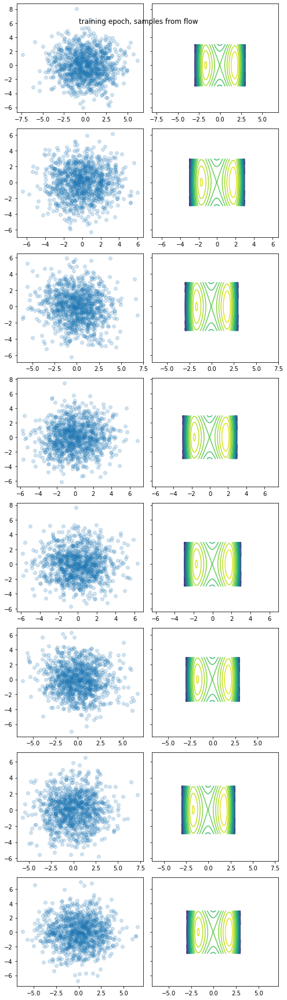

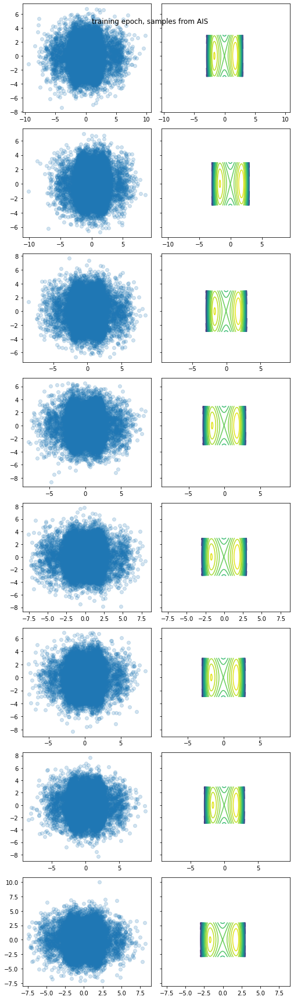

In [20]:
plot_samples_vs_contours_many_well(tester, n_samples=1000,
                                      title=f"training epoch, samples from flow")
plot_samples_vs_contours_many_well(tester, n_samples=None,
                                      title=f"training epoch, samples from AIS",
                                      samples_q=info_dict_before["samples"])

## Run first iter

  0%|          | 0/6000 [00:00<?, ?it/s]

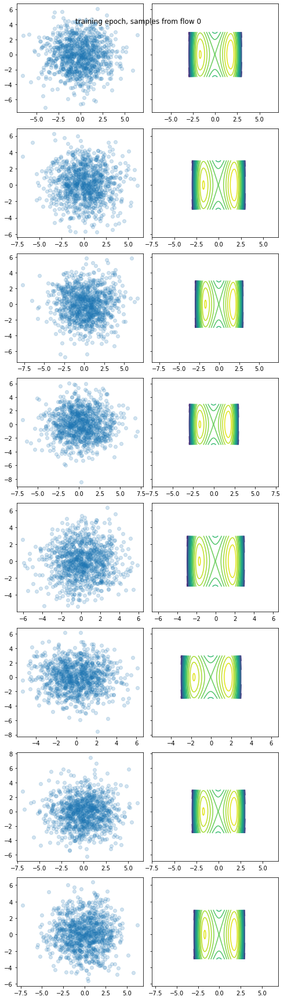

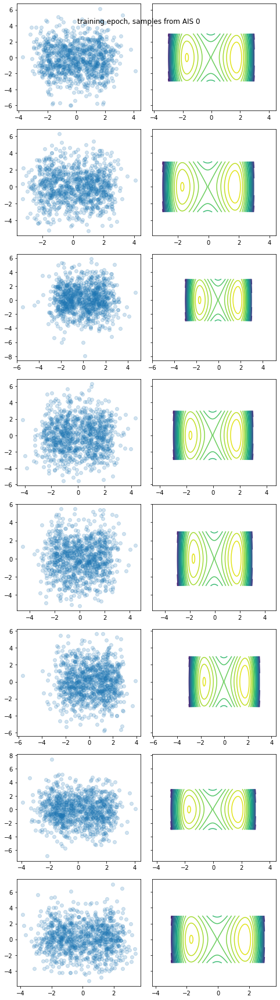

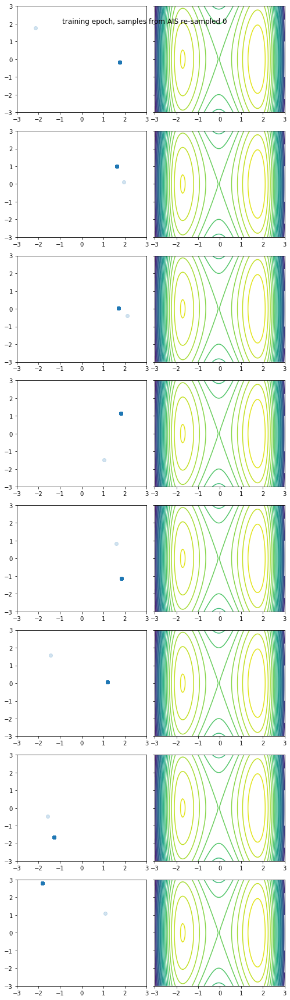

loss: 183.46411761887987,   log_p_x_post_AIS 63.61155097600618, ESS 0.027830105763534677:  10%|█         | 600/6000 [2:12:50<19:43:54, 13.15s/it]

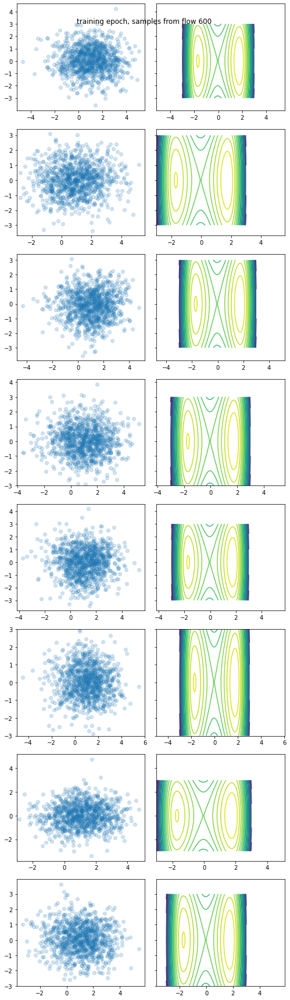

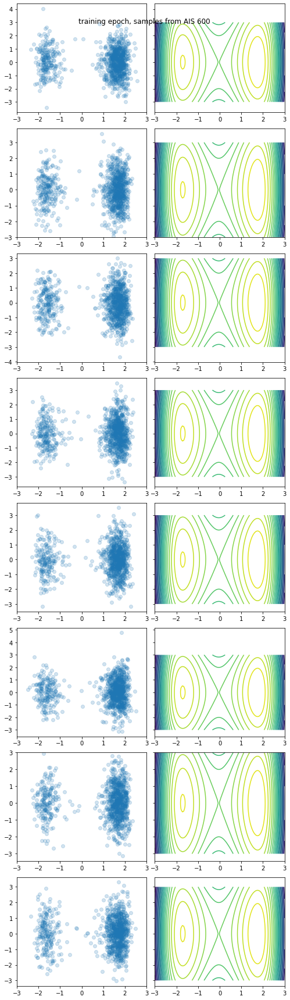

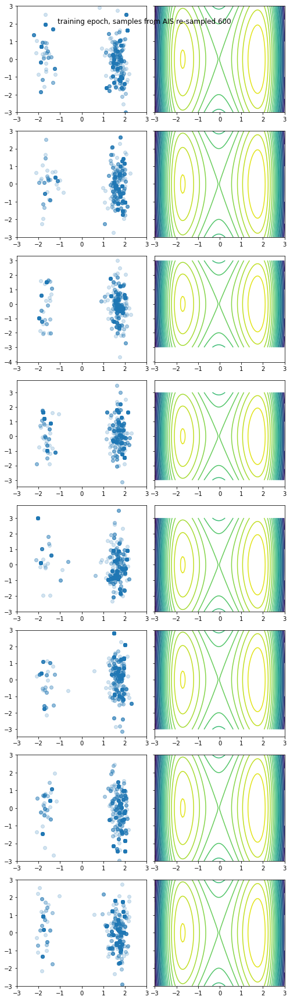

loss: 182.61461460397305,   log_p_x_post_AIS 64.67054558954005, ESS 0.03420337692200814:  20%|██        | 1200/6000 [4:25:26<18:17:43, 13.72s/it]

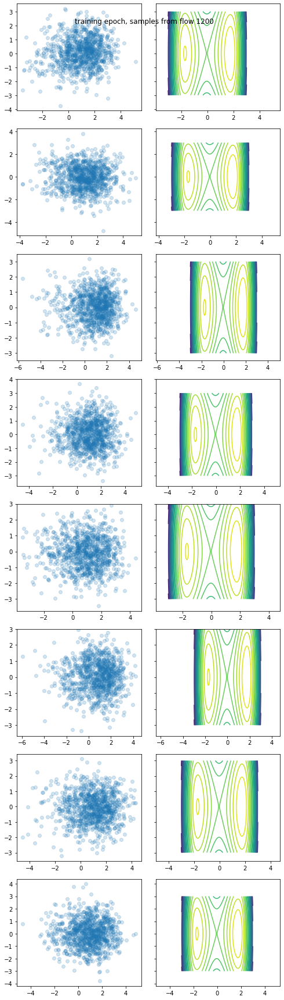

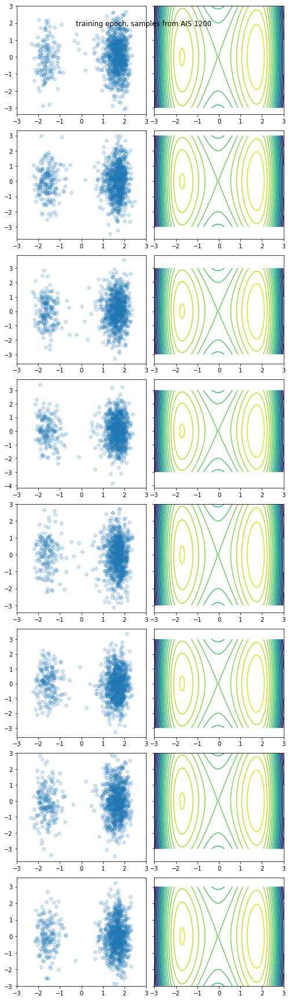

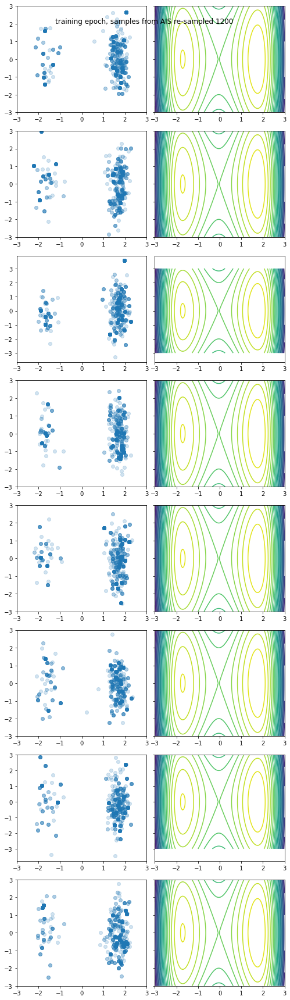

loss: 181.3490681138272,   log_p_x_post_AIS 63.71268584117639, ESS 0.0396006750799486:  30%|███       | 1800/6000 [6:37:37<15:15:12, 13.07s/it] 

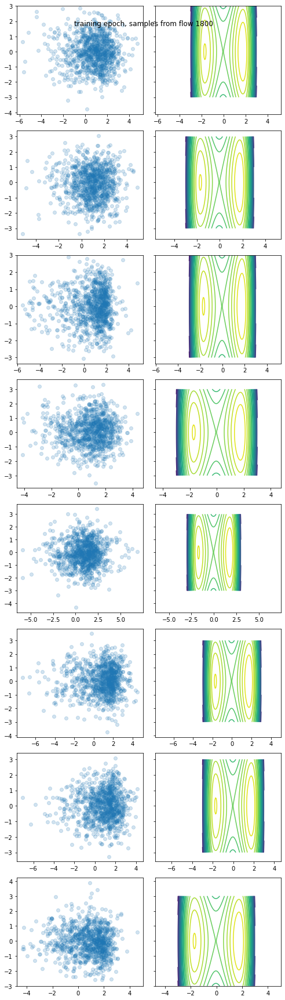

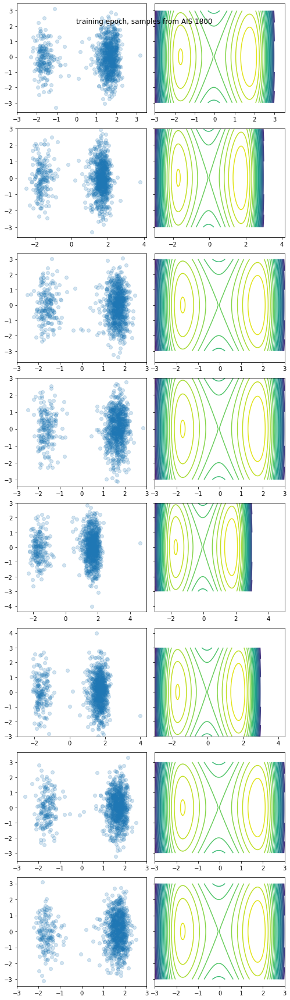

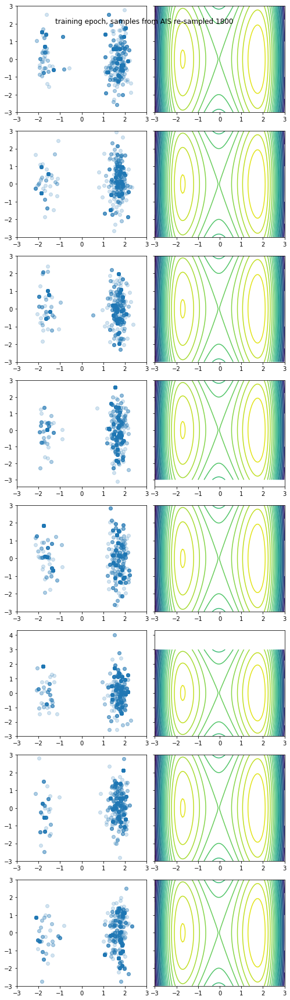

loss: 180.4487251296725,   log_p_x_post_AIS 62.6672100970281, ESS 0.042945267286956176:  40%|████      | 2400/6000 [8:48:40<13:15:31, 13.26s/it]

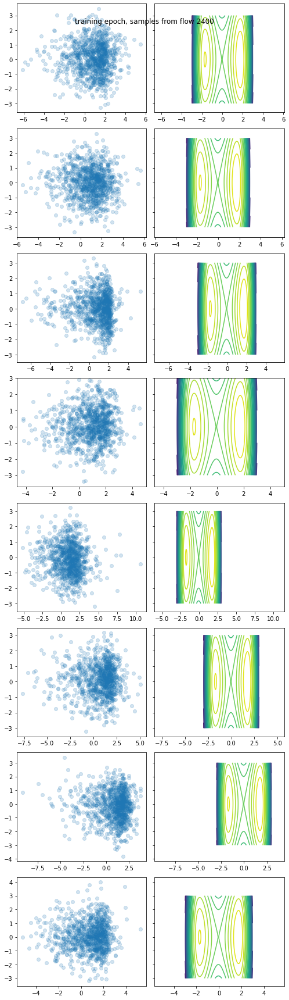

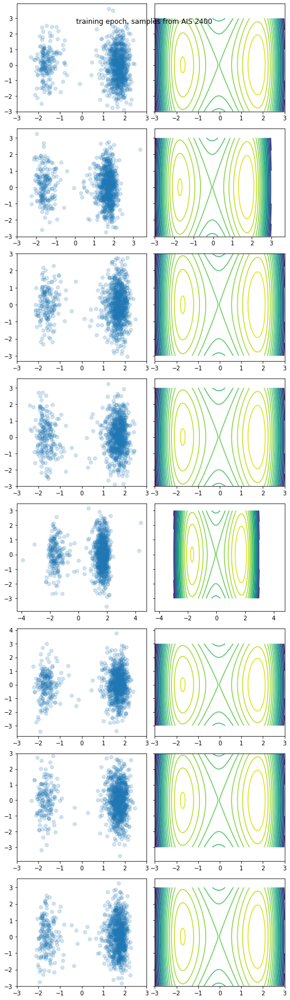

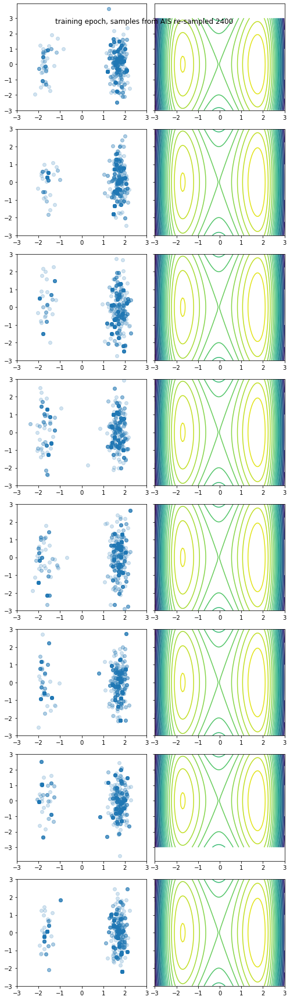

loss: 180.2613289344996,   log_p_x_post_AIS 62.19754392574562, ESS 0.05167369160305843:  48%|████▊     | 2877/6000 [10:33:04<11:30:29, 13.27s/it]

In [ ]:
history = tester.train(6000, batch_size=int(1e3), intermediate_plots=True, n_plots=10, plotting_func=plotter)

In [1]:
plot_history(history)

NameError: ignored

In [ ]:
plot_history(dict([(key, history[key]) for key in ('loss', 'log_p_x_after_AIS', 'log_w', 'kl', 
                                               'alpha_2_divergence', 'log_q_AIS_x', 'ESS')]))

In [ ]:
expectation, info_dict = tester.AIS_train.calculate_expectation(n_samples_expectation,
                                                                    expectation_function=expectation_function,
                                                                             batch_size=int(1e3),
                                                               drop_nan_and_infs=True)
print(info_dict['effective_sample_size'].item() / info_dict["normalised_sampling_weights"].shape[0])

In [ ]:
plot_samples_vs_contours_many_well(tester, n_samples=1000,
                                      title=f"training epoch, samples from flow")
plot_samples_vs_contours_many_well(tester, n_samples=None,
                                      title=f"training epoch, samples from AIS",
                                      samples_q=info_dict["samples"])

In [28]:
expectation_flo, info_dict_flo = tester.AIS_train.calculate_expectation_over_flow(n_samples_expectation,
                                                                    expectation_function=expectation_function,
                                                                             batch_size=int(1e3),
                                                               drop_nan_and_infs=True)
print(info_dict_flo['effective_sample_size'].item() / info_dict_flo["normalised_sampling_weights"].shape[0])

RuntimeError: ignored

# Run longer iter

  0%|          | 0/2000 [00:00<?, ?it/s]

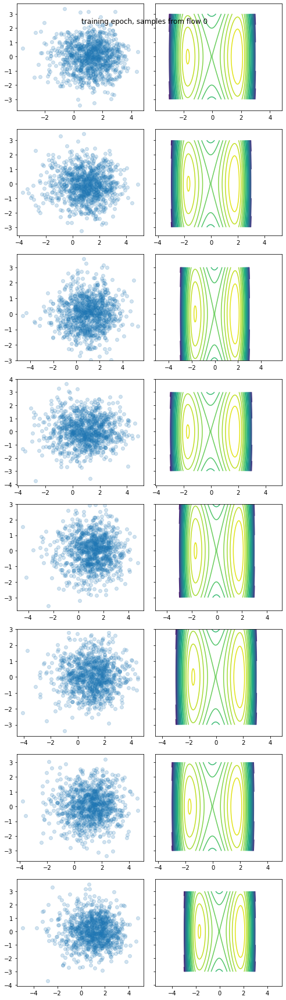

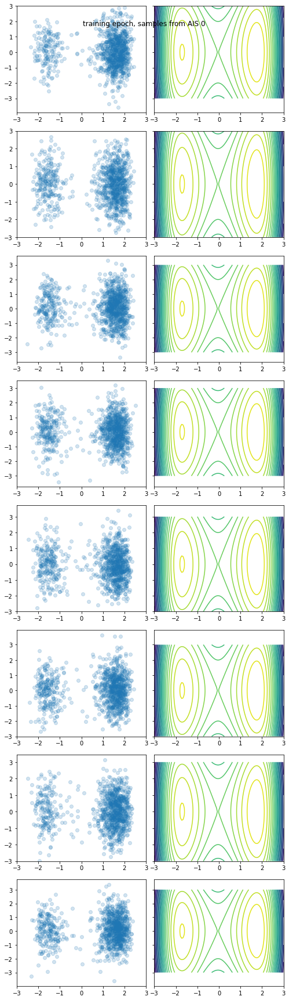

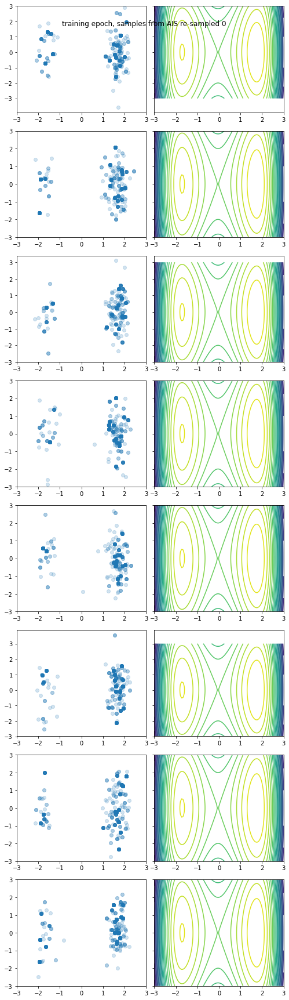

loss: 182.73780731033716,   log_p_x_post_AIS 60.52955899267259, ESS 0.01462947913468809:  10%|█         | 200/2000 [45:31<6:47:05, 13.57s/it] 

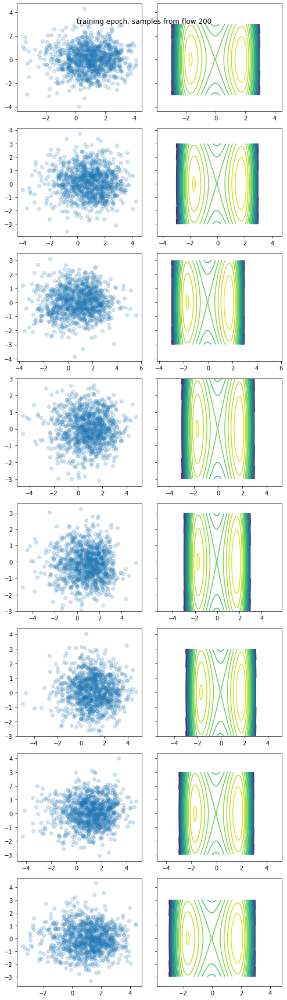

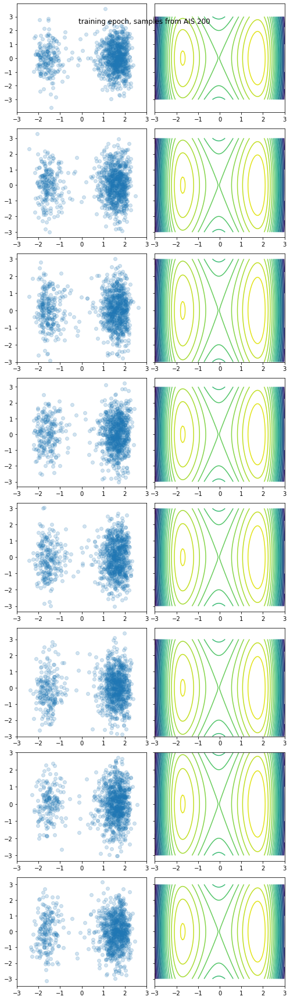

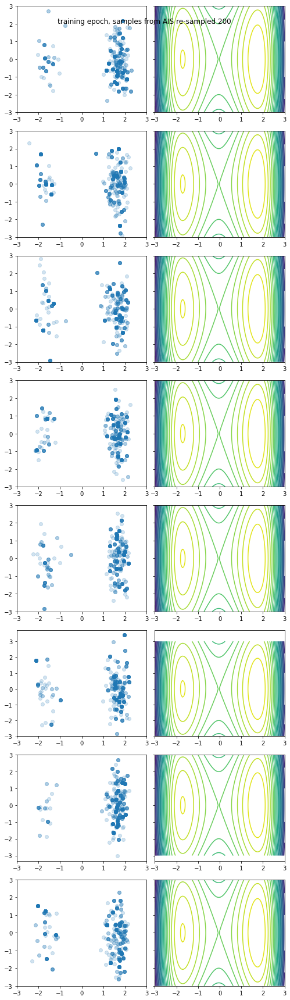

loss: 182.28350164935836,   log_p_x_post_AIS 61.01365600068632, ESS 0.014042981848394675:  20%|██        | 400/2000 [1:31:02<6:03:33, 13.63s/it]

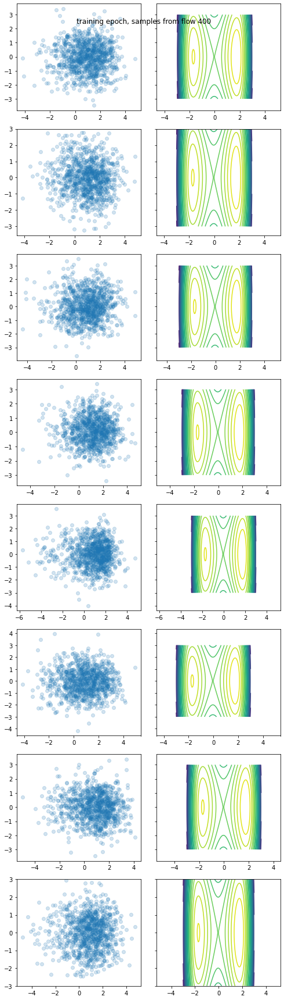

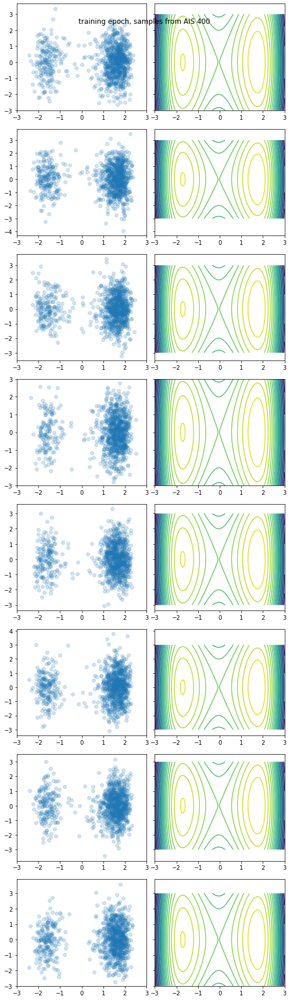

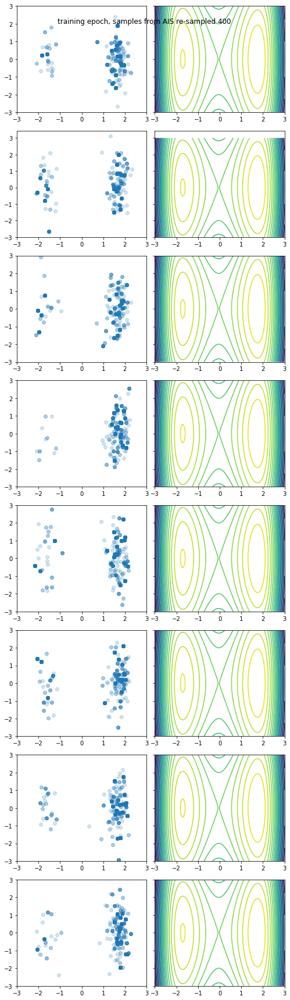

loss: 181.96868223137287,   log_p_x_post_AIS 61.787477022187375, ESS 0.015675876791486267:  30%|███       | 600/2000 [2:16:33<5:18:07, 13.63s/it]

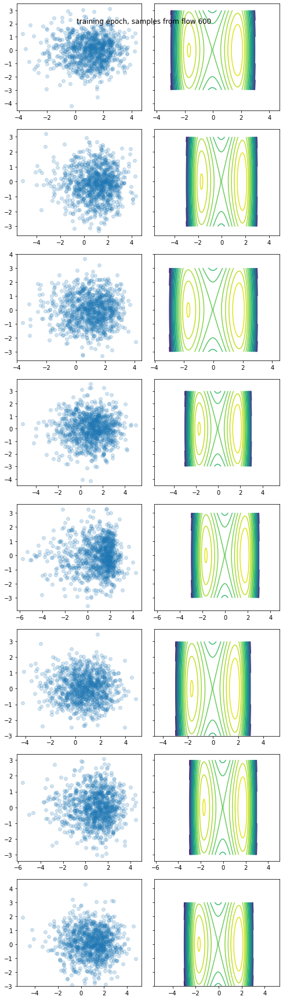

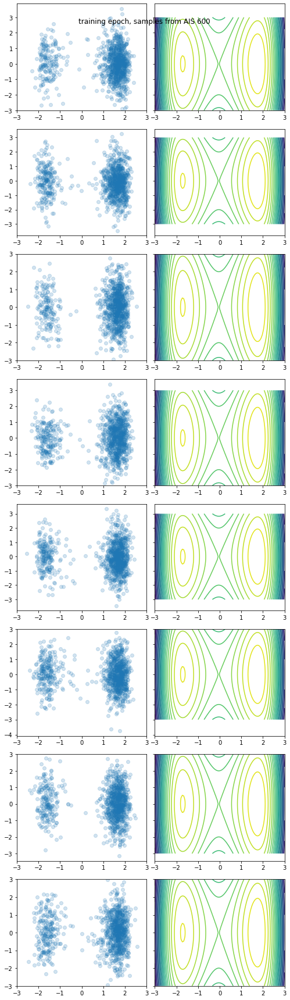

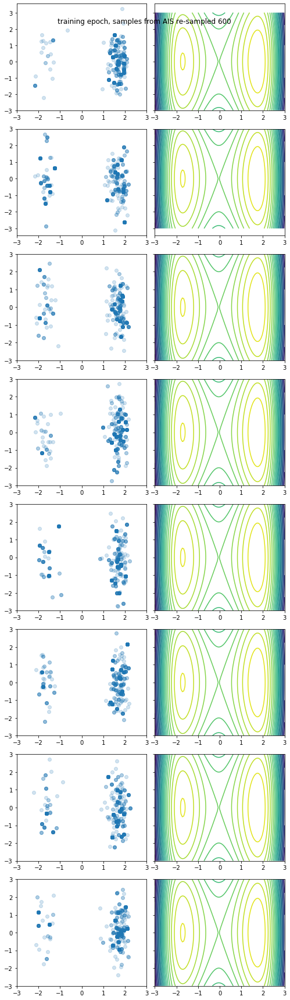

loss: 181.93181582500227,   log_p_x_post_AIS 61.079501809844274, ESS 0.014414506126028825:  40%|████      | 800/2000 [3:02:05<4:33:24, 13.67s/it]

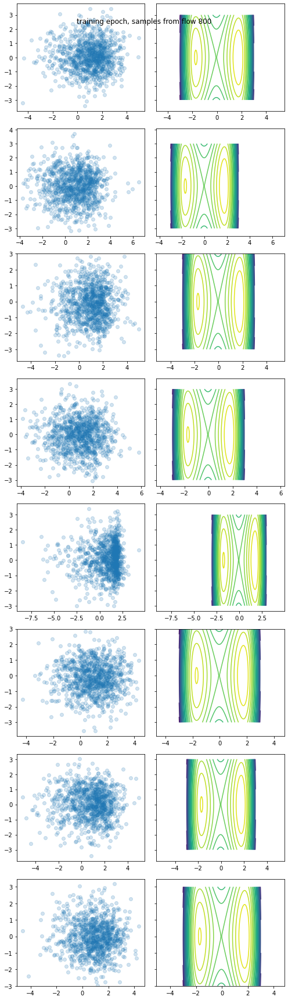

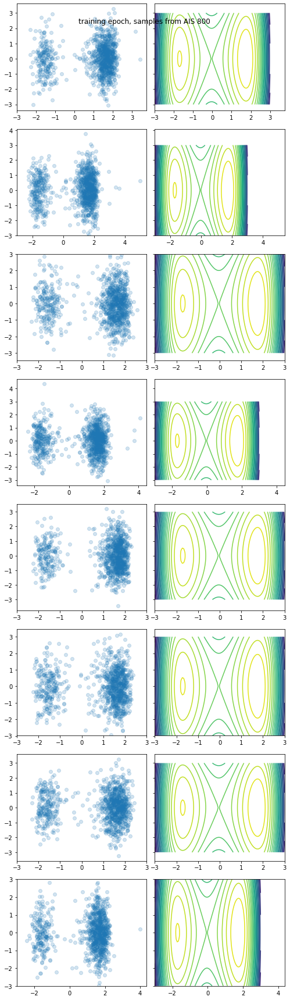

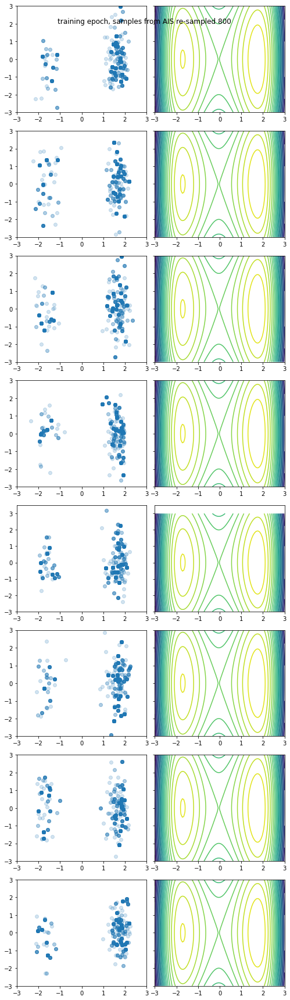

loss: 182.2851595701361,   log_p_x_post_AIS 61.36035866485876, ESS 0.01782454419176215:  50%|█████     | 1000/2000 [3:47:54<3:47:49, 13.67s/it]  

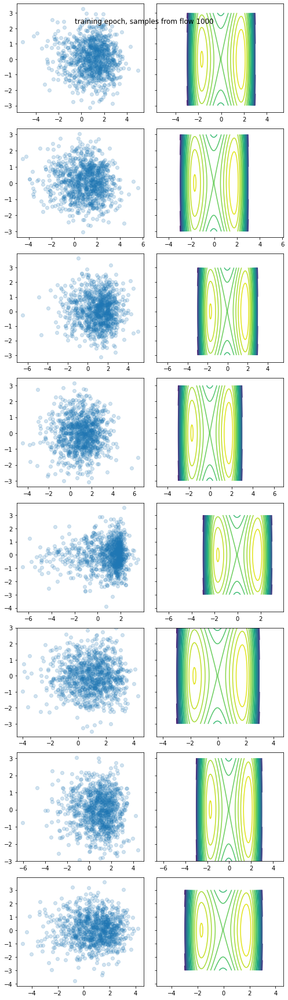

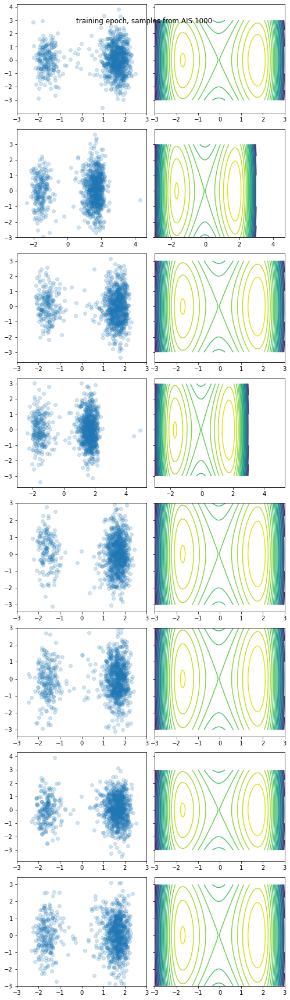

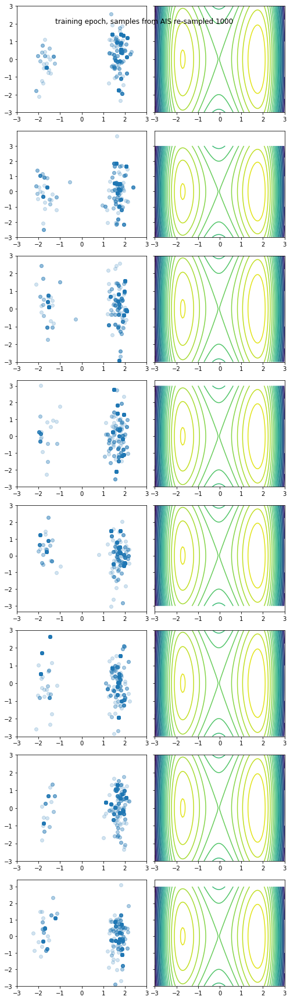

loss: 181.3568868735007,   log_p_x_post_AIS 61.444211303981476, ESS 0.025207649467179766:  60%|██████    | 1200/2000 [4:33:35<3:02:30, 13.69s/it]

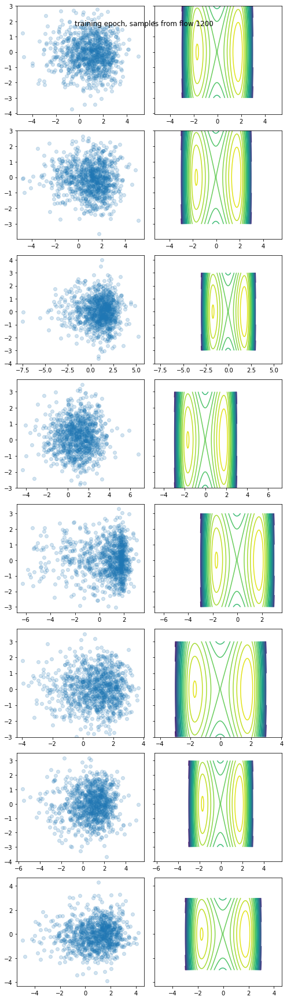

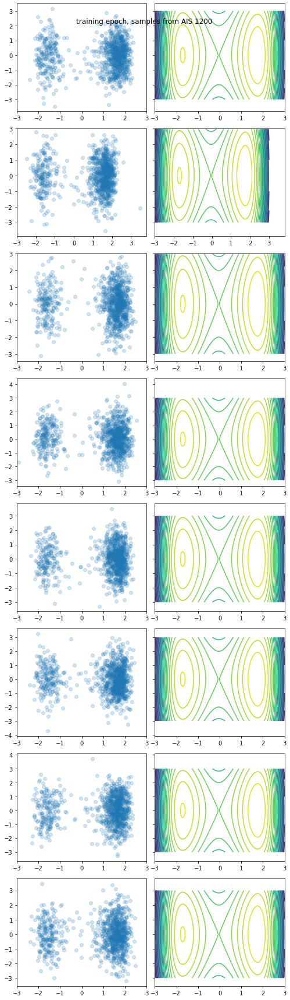

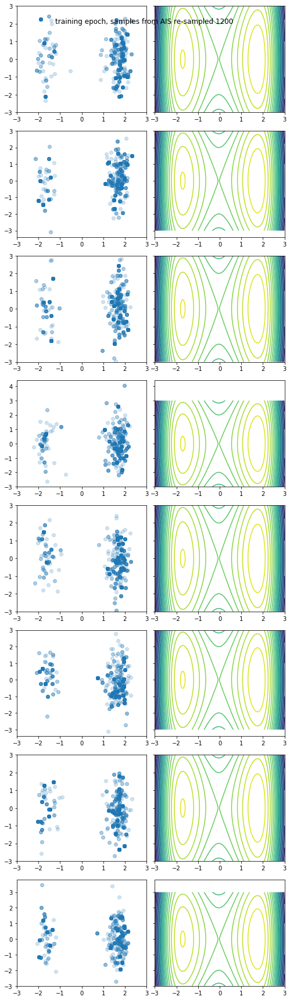

loss: 181.51276686697008,   log_p_x_post_AIS 61.36355481250981, ESS 0.024089693058124077:  70%|███████   | 1400/2000 [5:19:19<2:17:29, 13.75s/it] 

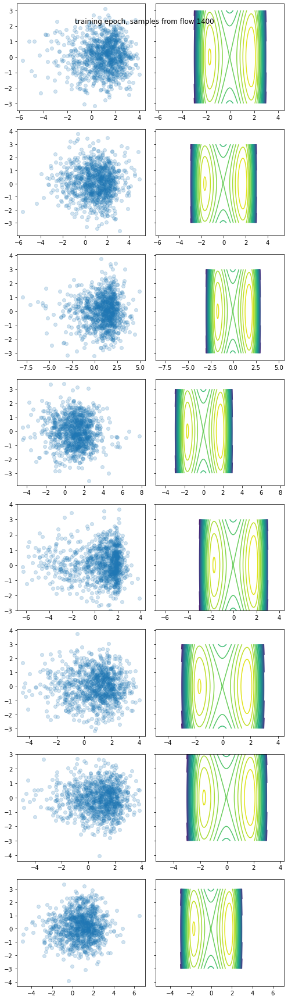

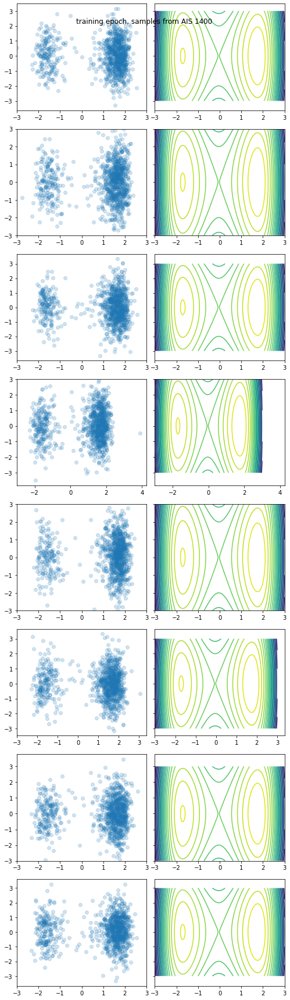

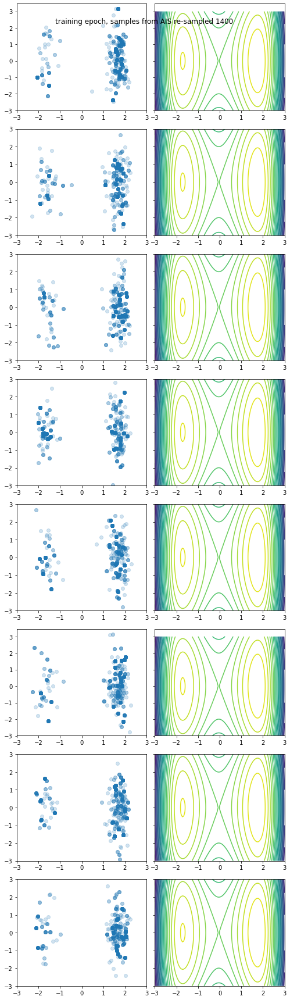

loss: 180.87905952069156,   log_p_x_post_AIS 61.26645848284953, ESS 0.02191035700822655:  80%|████████  | 1600/2000 [6:04:59<1:31:39, 13.75s/it] 

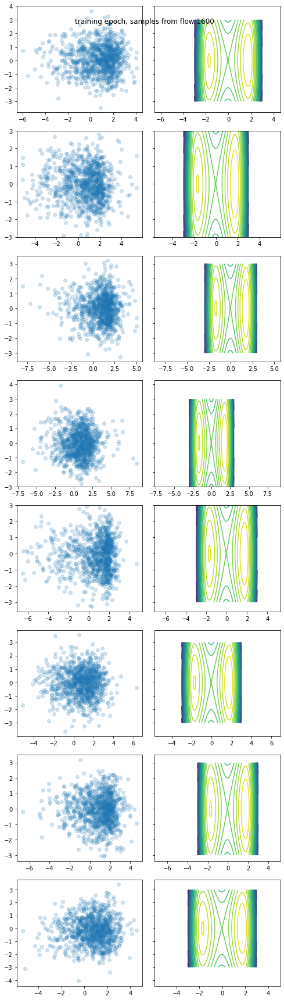

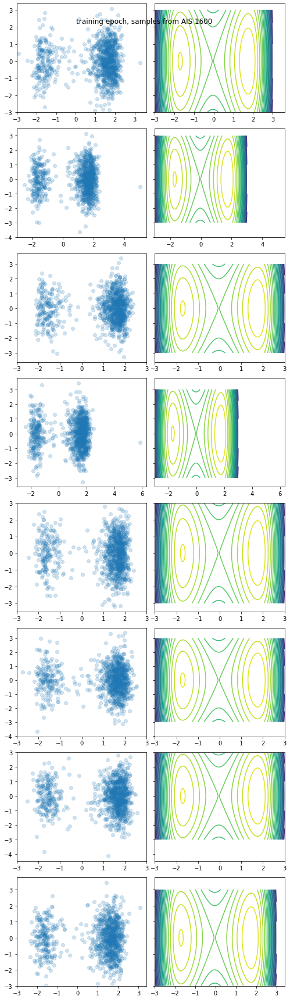

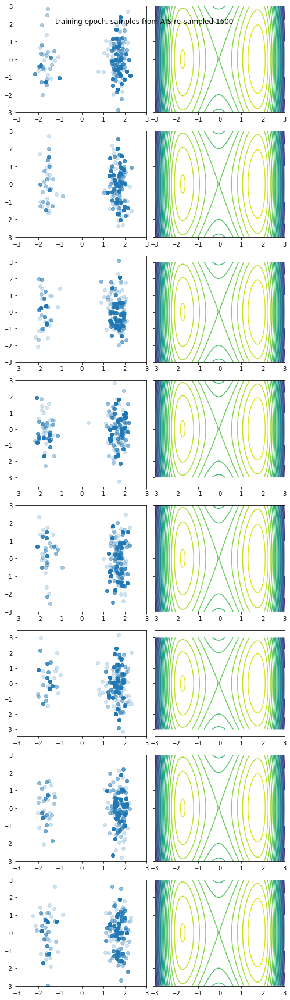

loss: 180.59536335653993,   log_p_x_post_AIS 60.62119014108547, ESS 0.020493043760955697:  90%|█████████ | 1800/2000 [6:50:34<46:11, 13.86s/it]

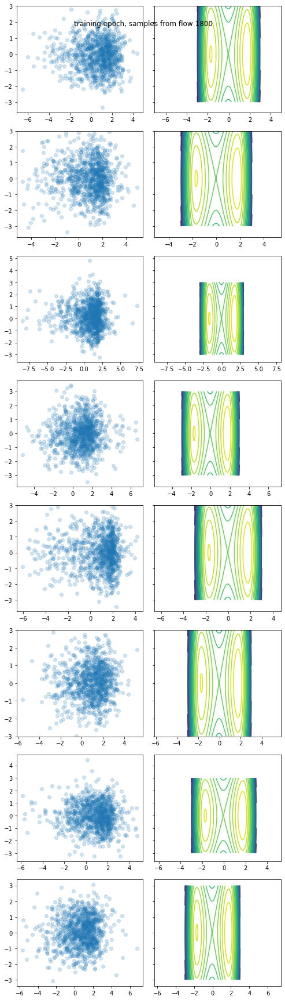

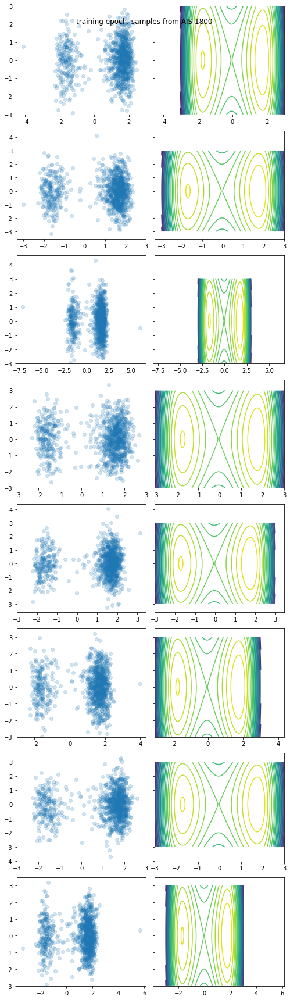

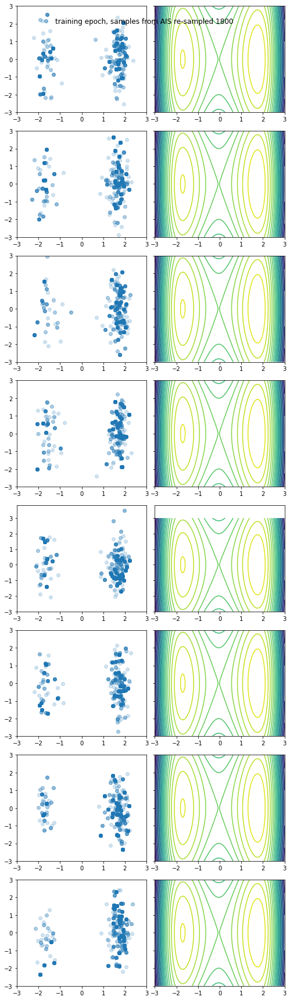

loss: 180.34323869384724,   log_p_x_post_AIS 59.68449686022832, ESS 0.027762600090423757: 100%|██████████| 2000/2000 [7:35:43<00:00, 13.67s/it]


In [30]:
history = tester.train(2000, batch_size=int(1e3), intermediate_plots=True, n_plots=10, plotting_func=plotter)

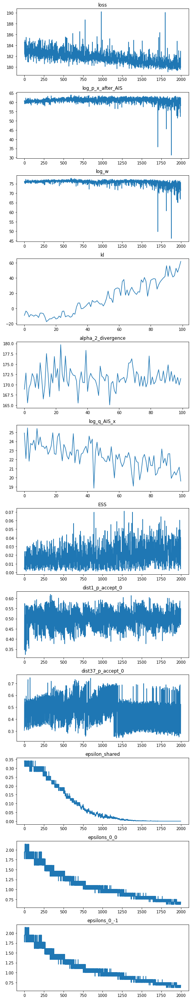

In [31]:
plot_history(history)

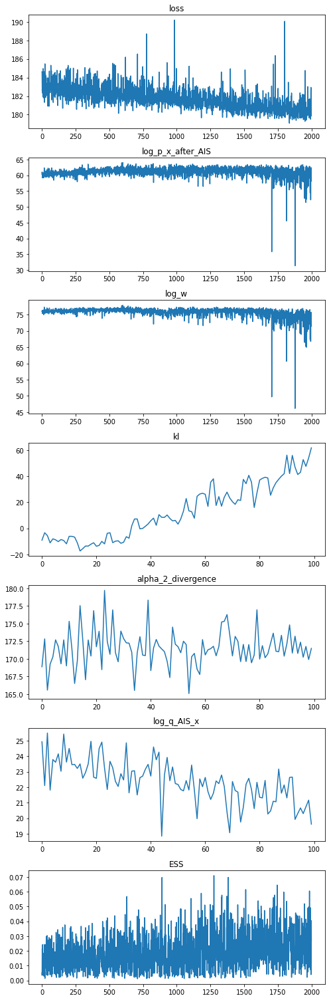

In [32]:
plot_history(dict([(key, history[key]) for key in ('loss', 'log_p_x_after_AIS', 'log_w', 'kl', 
                                               'alpha_2_divergence', 'log_q_AIS_x', 'ESS')]))

In [33]:
expectation, info_dict = tester.AIS_train.calculate_expectation(n_samples_expectation,
                                                                    expectation_function=expectation_function,
                                                                             batch_size=int(1e3),
                                                               drop_nan_and_infs=True)
print(info_dict['effective_sample_size'].item() / info_dict["normalised_sampling_weights"].shape[0])

0.009470622069875069


In [34]:
expectation_flo, info_dict_flo = tester.AIS_train.calculate_expectation_over_flow(n_samples_expectation,
                                                                    expectation_function=expectation_function,
                                                                             batch_size=int(1e3),
                                                               drop_nan_and_infs=True)
print(info_dict_flo['effective_sample_size'].item() / info_dict_flo["normalised_sampling_weights"].shape[0])

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py", line 2882, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-34-73aadc209def>", line 4, in <module>
    drop_nan_and_infs=True)
  File "/content/drive/My Drive/PytorchThesis/ImportanceSampling/AnnealedImportanceSampler.py", line 139, in calculate_expectation_over_flow
    samples_batch, log_q = self.sampling_distribution(n_samples)
  File "/usr/local/lib/python3.7/dist-packages/torch/nn/modules/module.py", line 1051, in _call_impl
    return forward_call(*input, **kwargs)
  File "/content/drive/My Drive/PytorchThesis/FittedModels/Models/FlowModel.py", line 67, in forward
    return self.z_to_x(batch_size=batch_size)
  File "/content/drive/My Drive/PytorchThesis/FittedModels/Models/FlowModel.py", line 87, in z_to_x
    x, log_determinant = flow_step.inverse(x)
  File "/content/drive/My Drive/PytorchThesis/NormalisingFlow/RealNVP.py",

RuntimeError: ignored

In [ ]:
plot_samples_vs_contours_many_well(tester, n_samples=1000,
                                      title=f"training epoch, samples from flow")
plot_samples_vs_contours_many_well(tester, n_samples=None,
                                      title=f"training epoch, samples from AIS",
                                      samples_q=info_dict["samples"])

# Run longer iter

In [35]:
history = tester.train(3000, batch_size=int(1e3), intermediate_plots=True, n_plots=10, plotting_func=plotter)

  0%|          | 0/3000 [00:00<?, ?it/s]ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py", line 2882, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-35-2f97d7b8cdc6>", line 1, in <module>
    history = tester.train(3000, batch_size=int(1e3), intermediate_plots=True, n_plots=10, plotting_func=plotter)
  File "/content/drive/My Drive/PytorchThesis/AIS_train/train_AIS.py", line 112, in train
    x_samples, log_w = self.AIS_train.run(batch_size)
  File "/content/drive/My Drive/PytorchThesis/AIS_train/AnnealedImportanceSampler.py", line 59, in run
    x_new, log_w = self.perform_transition(x_new, log_w, j)
  File "/content/drive/My Drive/PytorchThesis/AIS_train/AnnealedImportanceSampler.py", line 66, in perform_transition
    x_new = self.transition_operator_class.run(x_new, target_p_x, j-1)
  File "/content/drive/My Drive/PytorchThesis/ImportanceSampling/SamplingAlgorithms/HamiltonianMonteCarlo.py", line 137, in run
    re

RuntimeError: ignored

In [ ]:
plot_history(history)

In [ ]:
plot_history(dict([(key, history[key]) for key in ('loss', 'log_p_x_after_AIS', 'log_w', 'kl', 
                                               'alpha_2_divergence', 'log_q_AIS_x', 'ESS')]))

In [ ]:
expectation, info_dict = tester.AIS_train.calculate_expectation(n_samples_expectation,
                                                                    expectation_function=expectation_function,
                                                                             batch_size=int(1e3),
                                                               drop_nan_and_infs=True)
print(info_dict['effective_sample_size'].item() / info_dict["normalised_sampling_weights"].shape[0])

In [ ]:
expectation_flo, info_dict_flo = tester.AIS_train.calculate_expectation_over_flow(n_samples_expectation,
                                                                    expectation_function=expectation_function,
                                                                             batch_size=int(1e3),
                                                               drop_nan_and_infs=True)
print(info_dict_flo['effective_sample_size'].item() / info_dict_flo["normalised_sampling_weights"].shape[0])

In [ ]:
plot_samples_vs_contours_many_well(tester, n_samples=1000,
                                      title=f"training epoch, samples from flow")
plot_samples_vs_contours_many_well(tester, n_samples=None,
                                      title=f"training epoch, samples from AIS",
                                      samples_q=info_dict["samples"])